In [1]:
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows", None)

In [2]:
df=pd.read_csv('./Day 14 Students files/PBL5recommendationdata.csv',encoding='iso-8859-1')

In [3]:
#EDA

In [4]:
df.head()

,Customers.id,Customers.fname,Customers.lname,Customers.company,Customers.create_date,Customers.status,Customers.mailing,Customers.reminders,Customers.tax_exempt,Customers.account_id,Customers.sales_rep,Customers.rewards,Customers.profile_id,Customers.last_modified,Customers.customer_type,Orders.id,Orders.customer_id,Orders.fname,Orders.lname,Orders.company,Orders.order_number,Orders.reorder_id,Orders.external_source,Orders.external_id,Orders.currency,Orders.sales_rep,Orders.subtotal,Orders.tax,Orders.shipping,Orders.coupon_id,Orders.coupon_amount,Orders.gift_id,Orders.gift_amount,Orders.fee_name,Orders.fee_amount,Orders.discount_name,Orders.discount_amount,Orders.total,Orders.balance_due,Orders.shipping_carrier,Orders.shipping_method,Orders.shipping_trans,Orders.shipping_flags,Orders.weight,Orders.tracking,Orders.payment_status,Orders.payment_date,Orders.payment_user,Orders.payment_type,Orders.payment_method,Orders.payment_amount,Orders.purchase_order,Orders.payment_id,Orders.payment_code,Orders.payment_ref,Orders.status,Orders.placed_date,Orders.updated_date,Orders.shipped_date,Orders.comments,Orders.notes,Orders.registry_id,Orders.gift_message,Orders.website,Orders.mailing,Orders.flags,Orders.partial_ship,Orders.customer_type,Order_Items.id,Order_Items.parent,Order_Items.product_id,Order_Items.product_name,Order_Items.attributes,Order_Items.attribute_names,Order_Items.attribute_prices,Order_Items.qty,Order_Items.price,Order_Items.cost,Order_Items.registry_item,Order_Items.related_id,Order_Items.reorder_frequency,Order_Items.account_id,Order_Items.flags,Products.id,Products.status,Products.product_type,Products.template,Products.vendor,Products.import_id,Products.name,Products.display_name,Products.menu_name,Products.list_price,Products.price,Products.sale_price,Products.cost,Products.flags,Products.left_flag,Products.right_flag,Products.last_modified,Products.taxable,Products.shopping_gtin,Products.shopping_brand,Products.shopping_mpn,Products.shopping_gender,Products.shopping_color,Products.shopping_age,Products.shopping_flags,Products.amazon_asin,Products.amazon_type,Products.amazon_item_type,Products.amazon_price,Products.google_shopping_id,Products.google_shopping_type,Products.google_shopping_cat,Products.google_adwords,Products.shopping_cat,Products.shopping_type,Products.pricegrabber_cat,Products.shopzilla_cat,Products.thefind_cat,Products.quickbooks_id,Products.qb_edit_sequence,Products.price_break_type,Products.price_breaks,Products.short_description,Products.long_description,Products.websites,Products.video,Products.audio,Products.seo_title,Products.seo_description,Products.seo_keywords,Products.seo_header,Products.seo_footer,Products.seo_url,Products.seo_category,Products.unit,Products.packaging,Products.display_packaging,Products.multiple,Products.length,Products.width,Products.height,Products.rx,Products.latex,Products.upc,Products.msds_link,Products.msds_label,Products.lit_link,Products.lit_label,Products.hcpcs,Products.case_qty,Products.markup,Products.override_markup,Products.notes,Products.import_flags,Products.map_price,Products.features_title,Products.warranty,Products.hygienic,Products.default_quantity,Products.user_size,Products.assembly,Products.installation,Products.shipping_length,Products.shipping_width,Products.shipping_height,Products.shipping_weight,Products.handling_time,Products.rotation_link,Products.google_shopping_label,Products.product_option,Products.size,Products.material,Products.arm_style,Products.leg_style,Products.seat_size,Products.family_id,Products.saved_status,Products.freight_cost
0,797,Christy,Dill,Company0,1426018724,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1437764306,0.0,3758,797,Christy,Dill,Company0,3758,NaN,NaN,NaN,USD,NaN,57.20,0.0,9.95,13.0,2.86,NaN,NaN,NaN,NaN,NaN,NaN,64.29,NaN,fedex,11|Ground,NaN,NaN,NaN,5.7204E+14,3.0,1.426019e+09,NaN,authorize.net,NaN,64.29,NaN,6993607863,510142,NaN,1,1426019099,1.438868e+09,1.426101e+09,NaN,Insured By Eye4Fraud,NaN,NaN,NaN,NaN,NaN,NaN,0.0,528

In [6]:
df.shape

(4194, 181)

In [7]:
df.isnull().sum()

Customers.id                         0
Customers.fname                      0
Customers.lname                      0
Customers.company                 3467
Customers.create_date                0
Customers.status                  4093
Customers.mailing                 2080
Customers.reminders               4194
Customers.tax_exempt              4189
Customers.account_id              4191
Customers.sales_rep               4194
Customers.rewards                 4194
Customers.profile_id              4194
Customers.last_modified              0
Customers.customer_type            423
Orders.id                            0
Orders.customer_id                   0
Orders.fname                         0
Orders.lname                         0
Orders.company                    3466
Orders.order_number                  0
Orders.reorder_id                 4112
Orders.external_source            3829
Orders.external_id                4189
Orders.currency                      0
Orders.sales_rep         

In [9]:
# Step 1: Calculate the number of null values in each column
null_counts = df.isnull().sum()

# Step 2: Identify columns with more than 3000 null values
columns_to_drop = null_counts[null_counts > 3000].index

# Step 3: Drop the identified columns from the dataset
df = df. drop (columns=columns_to_drop)

In [10]:
df.shape

(4194, 94)

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4194 entries, 0 to 4193
Data columns (total 94 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Customers.id                   4194 non-null   int64  
 1   Customers.fname                4194 non-null   object 
 2   Customers.lname                4194 non-null   object 
 3   Customers.create_date          4194 non-null   int64  
 4   Customers.mailing              2114 non-null   float64
 5   Customers.last_modified        4194 non-null   int64  
 6   Customers.customer_type        3771 non-null   float64
 7   Orders.id                      4194 non-null   int64  
 8   Orders.customer_id             4194 non-null   int64  
 9   Orders.fname                   4194 non-null   object 
 10  Orders.lname                   4194 non-null   object 
 11  Orders.order_number            4194 non-null   object 
 12  Orders.currency                4194 non-null   o

In [12]:
df.isnull().sum()

Customers.id                        0
Customers.fname                     0
Customers.lname                     0
Customers.create_date               0
Customers.mailing                2080
Customers.last_modified             0
Customers.customer_type           423
Orders.id                           0
Orders.customer_id                  0
Orders.fname                        0
Orders.lname                        0
Orders.order_number                 0
Orders.currency                     0
Orders.subtotal                     0
Orders.tax                        457
Orders.shipping                   195
Orders.total                        0
Orders.shipping_carrier           617
Orders.shipping_method            443
Orders.tracking                   376
Orders.payment_status               5
Orders.payment_date                18
Orders.payment_user              2814
Orders.payment_type               384
Orders.payment_amount              18
Orders.payment_id                 430
Orders.payme

In [13]:
df.head()

,Customers.id,Customers.fname,Customers.lname,Customers.create_date,Customers.mailing,Customers.last_modified,Customers.customer_type,Orders.id,Orders.customer_id,Orders.fname,Orders.lname,Orders.order_number,Orders.currency,Orders.subtotal,Orders.tax,Orders.shipping,Orders.total,Orders.shipping_carrier,Orders.shipping_method,Orders.tracking,Orders.payment_status,Orders.payment_date,Orders.payment_user,Orders.payment_type,Orders.payment_amount,Orders.payment_id,Orders.payment_code,Orders.status,Orders.placed_date,Orders.updated_date,Orders.shipped_date,Orders.notes,Orders.customer_type,Order_Items.id,Order_Items.parent,Order_Items.product_id,Order_Items.product_name,Order_Items.qty,Order_Items.price,Order_Items.cost,Products.id,Products.status,Products.template,Products.vendor,Products.import_id,Products.name,Products.display_name,Products.list_price,Products.price,Products.cost,Products.flags,Products.left_flag,Products.last_modified,Products.taxable,Products.shopping_gtin,Products.shopping_brand,Products.shopping_mpn,Products.shopping_color,Products.shopping_flags,Products.amazon_asin,Products.amazon_item_type,Products.google_shopping_id,Products.google_shopping_type,Products.google_shopping_cat,Products.shopping_cat,Products.shopping_type,Products.pricegrabber_cat,Products.shopzilla_cat,Products.thefind_cat,Products.quickbooks_id,Products.qb_edit_sequence,Products.short_description,Products.long_description,Products.seo_title,Products.seo_url,Products.seo_category,Products.unit,Products.packaging,Products.multiple,Products.latex,Products.upc,Products.lit_link,Products.lit_label,Products.hcpcs,Products.case_qty,Products.override_markup,Products.import_flags,Products.hygienic,Products.shipping_length,Products.shipping_width,Products.shipping_height,Products.size,Products.family_id,Products.saved_status
0,797,Christy,Dill,1426018724,NaN,1437764306,0.0,3758,797,Christy,Dill,3758,USD,57.20,0.0,9.95,64.29,fedex,11|Ground,5.7204E+14,3.0,1.426019e+09,NaN,authorize.net,64.29,6993607863,510142,1,1426019099,1.438868e+09,1.426101e+09,Insured By Eye4Fraud,0.0,5284,3758,2310.0,"Basic Rollators, Green",1,57.20,44.00,2310.0,0.0,sub-product-detail.html,1.0,3.0,"Basic Steel Rollators,Green","Basic Lightweight Rollators For Adults, With S...",80.70,57.64,44.00,0.0,NaN,1.463163e+09,1.0,1.088440e+13,MEDLINE,MDS86850EGS,Green,62.0,B00I6GQE0A,health-care-products,generic/online%3Aen%3AUS%3A2310,"Walking Aids > Rollators, & Walkers > Rollators",Health & Beauty > Health Care,NaN,NaN,NaN,NaN,NaN,8000064C-1434298761,1.450325e+09,"ROLLATOR,BASIC,STEEL,6"",GREEN","<ul><li> Classically designed, value priced</...","Basic Lightweight Rollators For Adults, With S...",Basic-Rollators-For-Adults-With-Seat-Green-6-W...,0.0,EA,1 Each / Each,1 EA,NaN,NaN,NaN,NaN,E0149 +E0156,1.0,0.0,136.0,0.0,24.80,7.50,30.40,NaN,PF61071,0.0
1,3,John,Smith,1386089139,NaN,1437764354,0.0,23,3,John,Smith,23,USD,20.00,NaN,9.99,29.99,fedex,11|Ground,1.28597E+14,3.0,1.386090e+09,NaN,authorize.net,29.99,0,0,1,1386090455,1.440529e+09,1.386103e+09,NaN,0.0,31,23,177.0,"Urinary Drain Bags,0.000",4,5.00,1.87,177.0,1.0,sub-product-detail.html,1.0,3.0,Urinary Drain Bags,Urinary Drain Bags,14.41,10.29,1.87,65.0,NaN,1.462370e+09,1.0,1.008020e+13,MEDLINE,DYNC1674H,NaN,62.0,B000QF7Y76,health-care-products,NaN,"Incontinence, Urology & Ostomy > Urology > Dra...",Health & Beauty > Health Care,199.0,Miscellaneous,Health & Beauty > Medical Supplies > Medical Aids,22005.0,Health & Beauty > Medical Supplies > Medical Aids,80008C35-1438901283,1.450322e+09,"BAG,DRAINAGE,UROLOGY,2000ML,ANTI REFLUX",<ul><li> Only Medline drain bags have a slide...,Urinary Drain Bags | MEDLINE - DYNC1674H,Urinary-Drain-Bags0000,0.0,EA,1 Each / Each,1 EA,Yes,NaN,https://medline360.medline.com:443/irj/servlet...,508f2d75-582e-2e10-2eab-d83980a9b1d0,A4357,1.0,0.0,0.0,0.0,8.00,7.00,1.50,NaN,PF02132,NaN
2,3,John,Smith,1386089139,NaN,1437764354,0.0,9531,3,John,Smith,9531,USD,68.78,0.0,9.95,78.73,manual,0|Standard Shipping,NaN,3.

In [15]:
customers = df[['Customers.id', 'Customers.create_date', 'Customers.last_modified', 'Customers.customer_type']]

In [16]:
orders = df[['Orders.subtotal', 'Orders.total', 'Orders.payment_status', 'Orders.payment_date',
             'Orders.payment_amount', 'Orders.status']]

In [17]:
products = df[['Products.list_price', 'Products.price', 'Products.cost', 'Products.status']]

In [18]:
customers['Customers.customer_type'].value_counts()

Customers.customer_type
0.0    3319
1.0     386
2.0      66
Name: count, dtype: int64

In [20]:
customers['Customers.customer_type']=customers['Customers.customer_type'].fillna(0.0)

In [21]:
orders['Orders.payment_amount'].value_counts()

Orders.payment_amount
129.99     39
16.23      27
132.99     23
22.66      20
14.85      19
116.30     19
129.90     18
58.99      15
127.99     14
37.99      14
33.99      13
40.40      13
76.38      13
164.56     12
32.99      12
135.99     11
51.94      11
39.99      11
18.39      10
24.90      10
386.18     10
125.99      9
27.99       9
160.29      9
35.33       9
259.30      8
67.15       8
270.64      8
938.18      8
48.03       8
34.35       8
49.14       8
33.20       8
71.52       8
177.33      8
66.38       8
56.12       8
156.00      7
87.94       7
62.06       7
32.72       7
139.99      7
61.15       7
331.90      7
34.99       7
77.99       7
38.95       7
78.94       7
104.95      7
24.99       7
64.49       7
64.05       7
97.45       6
1038.30     6
46.35       6
65.45       6
101.58      6
1353.23     6
29.33       6
74.88       6
952.18      6
32.46       6
84.94       6
433.58      6
68.90       6
74.75       6
157.55      6
119.04      6
27.47       6
31.26       

In [23]:
orders['Orders.payment_amount']=orders['Orders.payment_amount'].fillna(orders['Orders.payment_amount'].mean())

In [24]:
orders.isnull().sum()

Orders.subtotal           0
Orders.total              0
Orders.payment_status     5
Orders.payment_date      18
Orders.payment_amount     0
Orders.status             0
dtype: int64

In [25]:
orders['Orders.payment_status'].value_counts()

Orders.payment_status
3.0    4115
1.0      50
0.0      24
Name: count, dtype: int64

In [27]:
orders['Orders.payment_status']=orders['Orders.payment_status'].fillna(orders['Orders.payment_status'].mode()[0])

In [28]:
orders['Orders.payment_date']=orders['Orders.payment_date'].fillna(orders['Orders.payment_date'].mean())

In [30]:
products.isnull().sum()

Products.list_price    177
Products.price         158
Products.cost          157
Products.status        157
dtype: int64

In [32]:
products['Products.list_price']=products['Products.list_price'].fillna(products['Products.list_price'].mean())

In [33]:
products['Products.price']=products['Products.price'].fillna(products['Products.price'].mean())

In [34]:
products['Products.cost']=products['Products.cost'].fillna(products['Products.cost'].mean())

In [36]:
products['Products.status'].value_counts()

Products.status
0.0    2647
3.0    1221
2.0     129
1.0      34
5.0       6
Name: count, dtype: int64

In [37]:
products['Products.status']=products['Products.status'].fillna(0.0)

In [38]:
customers.isnull().sum()

Customers.id               0
Customers.create_date      0
Customers.last_modified    0
Customers.customer_type    0
dtype: int64

In [39]:
import sqlite3

In [40]:
df1=pd.DataFrame(customers)
conn=sqlite3.connect('customers.db')
df1.to_sql('customers', conn, index=False,if_exists='replace')
conn.close ()

In [41]:
df1=pd.DataFrame(products)
conn=sqlite3.connect('products.db')
df1.to_sql('products', conn, index=False,if_exists='replace')
conn.close ()

In [42]:
df1=pd.DataFrame(orders)
conn=sqlite3.connect('orders.db')
df1.to_sql('orders', conn, index=False,if_exists='replace')
conn.close ()

In [43]:
conn=sqlite3.connect('products.db')
query= 'SELECT * FROM products'
products=pd.read_sql_query(query, conn)
conn.close()

In [44]:
products

,Products.list_price,Products.price,Products.cost,Products.status
0,80.700000,57.640000,44.000000,0.0
1,14.410000,10.290000,1.870000,1.0
2,96.290000,68.780000,52.500000,0.0
3,27.380000,19.560000,12.620000,0.0
4,50.470000,36.050000,25.750000,1.0
5,121.683321,74.266043,52.318192,0.0
6,121.683321,74.266043,52.318192,0.0
7,54.870000,39.190000,27.990000,0.0
8,84.290000,60.210000,45.960000,0.0
9,121.683321,74.266043,52.318192,0.0


In [45]:
conn=sqlite3.connect('orders.db')
query= 'SELECT * FROM orders'
orders=pd.read_sql_query(query, conn)
conn.close()

In [46]:
orders

,Orders.subtotal,Orders.total,Orders.payment_status,Orders.payment_date,Orders.payment_amount,Orders.status
0,57.20,64.29,3.0,1.426019e+09,64.290000,1
1,20.00,29.99,3.0,1.386090e+09,29.990000,1
2,68.78,78.73,3.0,1.449604e+09,78.730000,3
3,19.56,29.55,3.0,1.386780e+09,29.550000,1
4,36.05,46.00,3.0,1.386862e+09,46.000000,1
5,44.46,54.41,0.0,1.443104e+09,134.842263,1
6,14.63,24.58,3.0,1.410364e+09,24.580000,1
7,39.19,49.14,3.0,1.388156e+09,49.140000,1
8,59.75,69.70,3.0,1.389647e+09,69.700000,1
9,34.00,34.00,3.0,1.390510e+09,34.000000,1


In [47]:
conn=sqlite3.connect('customers.db')
query= 'SELECT * FROM customers'
customers=pd.read_sql_query(query, conn)
conn.close()

In [48]:
customers

,Customers.id,Customers.create_date,Customers.last_modified,Customers.customer_type
0,797,1426018724,1437764306,0.0
1,3,1386089139,1437764354,0.0
2,3,1386089139,1437764354,0.0
3,4,1386780263,1437762646,0.0
4,5,1386861599,1437764316,0.0
5,5,1386861599,1437764316,0.0
6,5,1386861599,1437764316,0.0
7,7,1388155947,1437763617,0.0
8,8,1389303216,1437763421,0.0
9,10,1390509516,1437763553,0.0


In [49]:
df2=pd.concat([customers,products,orders], axis=1)

In [50]:
df2

,Customers.id,Customers.create_date,Customers.last_modified,Customers.customer_type,Products.list_price,Products.price,Products.cost,Products.status,Orders.subtotal,Orders.total,Orders.payment_status,Orders.payment_date,Orders.payment_amount,Orders.status
0,797,1426018724,1437764306,0.0,80.700000,57.640000,44.000000,0.0,57.20,64.29,3.0,1.426019e+09,64.290000,1
1,3,1386089139,1437764354,0.0,14.410000,10.290000,1.870000,1.0,20.00,29.99,3.0,1.386090e+09,29.990000,1
2,3,1386089139,1437764354,0.0,96.290000,68.780000,52.500000,0.0,68.78,78.73,3.0,1.449604e+09,78.730000,3
3,4,1386780263,1437762646,0.0,27.380000,19.560000,12.620000,0.0,19.56,29.55,3.0,1.386780e+09,29.550000,1
4,5,1386861599,1437764316,0.0,50.470000,36.050000,25.750000,1.0,36.05,46.00,3.0,1.386862e+09,46.000000,1
5,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,44.46,54.41,0.0,1.443104e+09,134.842263,1
6,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,14.63,24.58,3.0,1.410364e+09,24.580000,1
7,7,1388155947,1437763617,0.0,54.870000,39.190000,27.990000,0.0,39.19,49.14,3.0,1.388156e+09,49.140000,1
8,8,1389303216,1437763421,0.0,84.290000,60.210000,45.960000,0.0,59.75,69.70,3.0,1.389647e+09,69.700000,1
9,10,1390509516,1437763553,0.0,121.683321,74.266043,52.318192,0.0,34.00,34.00,3.0,1.390510e+09,34.000000,1


In [51]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4194 entries, 0 to 4193
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Customers.id             4194 non-null   int64  
 1   Customers.create_date    4194 non-null   int64  
 2   Customers.last_modified  4194 non-null   int64  
 3   Customers.customer_type  4194 non-null   float64
 4   Products.list_price      4194 non-null   float64
 5   Products.price           4194 non-null   float64
 6   Products.cost            4194 non-null   float64
 7   Products.status          4194 non-null   float64
 8   Orders.subtotal          4194 non-null   float64
 9   Orders.total             4194 non-null   float64
 10  Orders.payment_status    4194 non-null   float64
 11  Orders.payment_date      4194 non-null   float64
 12  Orders.payment_amount    4194 non-null   float64
 13  Orders.status            4194 non-null   int64  
dtypes: float64(10), int64(4)

In [53]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.metrics import silhouette_score

In [54]:
model=KMeans(4)

In [55]:
model=model.fit(df2)

In [56]:
guess=model.predict(df2)

In [59]:
df2['cluster']=guess

In [60]:
df2['cluster'].value_counts()

cluster
1    1656
2    1047
3     941
0     550
Name: count, dtype: int64

In [61]:
df2

,Customers.id,Customers.create_date,Customers.last_modified,Customers.customer_type,Products.list_price,Products.price,Products.cost,Products.status,Orders.subtotal,Orders.total,Orders.payment_status,Orders.payment_date,Orders.payment_amount,Orders.status,cluster
0,797,1426018724,1437764306,0.0,80.700000,57.640000,44.000000,0.0,57.20,64.29,3.0,1.426019e+09,64.290000,1,2
1,3,1386089139,1437764354,0.0,14.410000,10.290000,1.870000,1.0,20.00,29.99,3.0,1.386090e+09,29.990000,1,0
2,3,1386089139,1437764354,0.0,96.290000,68.780000,52.500000,0.0,68.78,78.73,3.0,1.449604e+09,78.730000,3,2
3,4,1386780263,1437762646,0.0,27.380000,19.560000,12.620000,0.0,19.56,29.55,3.0,1.386780e+09,29.550000,1,0
4,5,1386861599,1437764316,0.0,50.470000,36.050000,25.750000,1.0,36.05,46.00,3.0,1.386862e+09,46.000000,1,0
5,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,44.46,54.41,0.0,1.443104e+09,134.842263,1,0
6,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,14.63,24.58,3.0,1.410364e+09,24.580000,1,0
7,7,1388155947,1437763617,0.0,54.870000,39.190000,27.990000,0.0,39.19,49.14,3.0,1.388156e+09,49.140000,1,0
8,8,1389303216,1437763421,0.0,84.290000,60.210000,45.960000,0.0,59.75,69.70,3.0,1.389647e+09,69.700000,1,0
9,10,1390509516,1437763553,0.0,121.683321,74.266043,52.318192,0.0,34.00,34.00,3.0,1.390510e+09,34.000000,1,0


In [62]:
silhouette_score(df2, guess)

0.5342276915199373

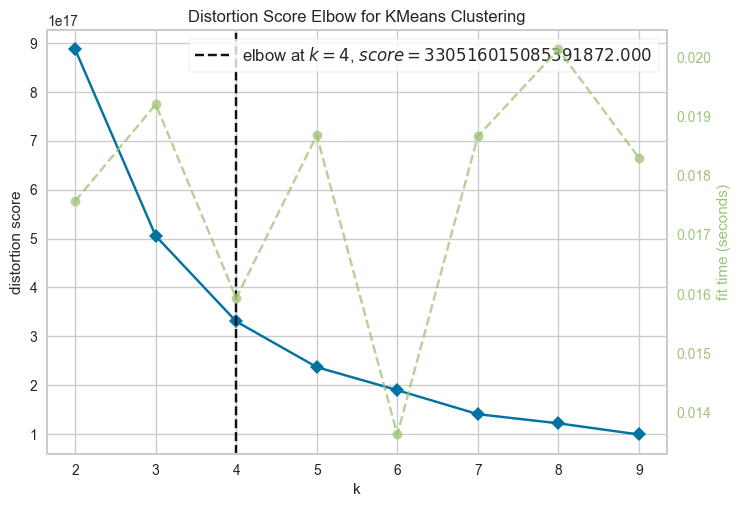

In [63]:
km = KMeans()

vis = KElbowVisualizer(km, k=(2,10))
vis.fit(df2)  
vis.show();

In [64]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

data=linkage(df2, method='ward', metric='euclidean')

{'icoord': [[5.0, 5.0, 15.0, 15.0],
  [25.0, 25.0, 35.0, 35.0],
  [45.0, 45.0, 55.0, 55.0],
  [30.0, 30.0, 50.0, 50.0],
  [10.0, 10.0, 40.0, 40.0],
  [65.0, 65.0, 75.0, 75.0],
  [85.0, 85.0, 95.0, 95.0],
  [70.0, 70.0, 90.0, 90.0],
  [125.0, 125.0, 135.0, 135.0],
  [115.0, 115.0, 130.0, 130.0],
  [105.0, 105.0, 122.5, 122.5],
  [155.0, 155.0, 165.0, 165.0],
  [145.0, 145.0, 160.0, 160.0],
  [113.75, 113.75, 152.5, 152.5],
  [80.0, 80.0, 133.125, 133.125],
  [25.0, 25.0, 106.5625, 106.5625],
  [175.0, 175.0, 185.0, 185.0],
  [195.0, 195.0, 205.0, 205.0],
  [180.0, 180.0, 200.0, 200.0],
  [225.0, 225.0, 235.0, 235.0],
  [215.0, 215.0, 230.0, 230.0],
  [245.0, 245.0, 255.0, 255.0],
  [222.5, 222.5, 250.0, 250.0],
  [190.0, 190.0, 236.25, 236.25],
  [265.0, 265.0, 275.0, 275.0],
  [295.0, 295.0, 305.0, 305.0],
  [285.0, 285.0, 300.0, 300.0],
  [270.0, 270.0, 292.5, 292.5],
  [335.0, 335.0, 345.0, 345.0],
  [325.0, 325.0, 340.0, 340.0],
  [315.0, 315.0, 332.5, 332.5],
  [355.0, 355.0, 365.0

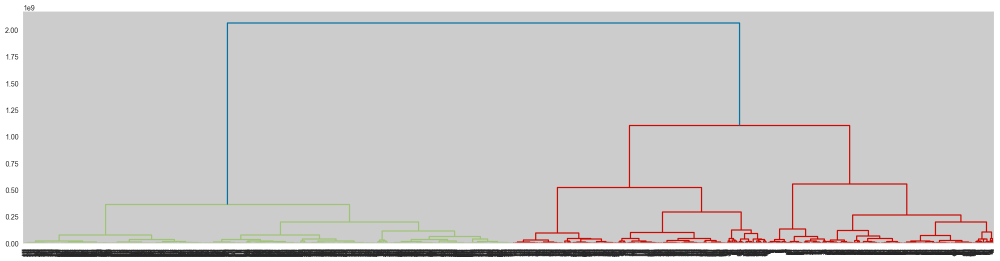

In [65]:
plt.figure(figsize=(25, 6))
dendrogram(data)

In [67]:
df2['customerID']=df['Customers.id']

In [68]:
df2

,Customers.id,Customers.create_date,Customers.last_modified,Customers.customer_type,Products.list_price,Products.price,Products.cost,Products.status,Orders.subtotal,Orders.total,Orders.payment_status,Orders.payment_date,Orders.payment_amount,Orders.status,cluster,customerID
0,797,1426018724,1437764306,0.0,80.700000,57.640000,44.000000,0.0,57.20,64.29,3.0,1.426019e+09,64.290000,1,2,797
1,3,1386089139,1437764354,0.0,14.410000,10.290000,1.870000,1.0,20.00,29.99,3.0,1.386090e+09,29.990000,1,0,3
2,3,1386089139,1437764354,0.0,96.290000,68.780000,52.500000,0.0,68.78,78.73,3.0,1.449604e+09,78.730000,3,2,3
3,4,1386780263,1437762646,0.0,27.380000,19.560000,12.620000,0.0,19.56,29.55,3.0,1.386780e+09,29.550000,1,0,4
4,5,1386861599,1437764316,0.0,50.470000,36.050000,25.750000,1.0,36.05,46.00,3.0,1.386862e+09,46.000000,1,0,5
5,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,44.46,54.41,0.0,1.443104e+09,134.842263,1,0,5
6,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,14.63,24.58,3.0,1.410364e+09,24.580000,1,0,5
7,7,1388155947,1437763617,0.0,54.870000,39.190000,27.990000,0.0,39.19,49.14,3.0,1.388156e+09,49.140000,1,0,7
8,8,1389303216,1437763421,0.0,84.290000,60.210000,45.960000,0.0,59.75,69.70,3.0,1.389647e+09,69.700000,1,0,8
9,10,1390509516,1437763553,0.0,121.683321,74.266043,52.318192,0.0,34.00,34.00,3.0,1.390510e+09,34.000000,1,0,10


In [69]:
df2['Orders.payment_date']=pd.to_datetime(df2["Orders.payment_date"], unit='s')

In [70]:
df2

,Customers.id,Customers.create_date,Customers.last_modified,Customers.customer_type,Products.list_price,Products.price,Products.cost,Products.status,Orders.subtotal,Orders.total,Orders.payment_status,Orders.payment_date,Orders.payment_amount,Orders.status,cluster,customerID
0,797,1426018724,1437764306,0.0,80.700000,57.640000,44.000000,0.0,57.20,64.29,3.0,2015-03-10 20:24:59.000000000,64.290000,1,2,797
1,3,1386089139,1437764354,0.0,14.410000,10.290000,1.870000,1.0,20.00,29.99,3.0,2013-12-03 17:07:35.000000000,29.990000,1,0,3
2,3,1386089139,1437764354,0.0,96.290000,68.780000,52.500000,0.0,68.78,78.73,3.0,2015-12-08 19:40:52.000000000,78.730000,3,2,3
3,4,1386780263,1437762646,0.0,27.380000,19.560000,12.620000,0.0,19.56,29.55,3.0,2013-12-11 16:44:23.000000000,29.550000,1,0,4
4,5,1386861599,1437764316,0.0,50.470000,36.050000,25.750000,1.0,36.05,46.00,3.0,2013-12-12 15:19:59.000000000,46.000000,1,0,5
5,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,44.46,54.41,0.0,2015-09-24 14:11:08.366379264,134.842263,1,0,5
6,5,1386861599,1437764316,0.0,121.683321,74.266043,52.318192,0.0,14.63,24.58,3.0,2014-09-10 15:40:55.000000000,24.580000,1,0,5
7,7,1388155947,1437763617,0.0,54.870000,39.190000,27.990000,0.0,39.19,49.14,3.0,2013-12-27 14:52:27.000000000,49.140000,1,0,7
8,8,1389303216,1437763421,0.0,84.290000,60.210000,45.960000,0.0,59.75,69.70,3.0,2014-01-13 21:10:43.000000000,69.700000,1,0,8
9,10,1390509516,1437763553,0.0,121.683321,74.266043,52.318192,0.0,34.00,34.00,3.0,2014-01-23 20:42:54.000000000,34.000000,1,0,10


In [72]:
now = pd.to_datetime('2024-03-14')
recency = now - df2.groupby('customerID')['Orders.payment_date'].max()
recency = recency.dt.days
frequency = df2.groupby('customerID')['Orders.payment_date'].count()
monetary = df2.groupby('customerID')['Orders.total'].sum()

In [73]:
rfm_df = pd.DataFrame({
    'Recency': recency,
    'Frequency': frequency,
    'Monetary': monetary
})

rfm_df

,Recency,Frequency,Monetary
customerID,,,
3,3018,2,108.72
4,3745,1,29.55
5,3093,3,124.99
7,3729,1,49.14
8,3712,1,69.70
10,3702,1,34.00
11,3647,1,34.00
12,3700,1,31.47
13,3312,3,322.93


In [ ]:
rfm = en son nezaman alisveris yapmis nekadar siklikla yapmis ve nekadar harcamis